In [2]:
import qiskit

In [3]:
import numpy as np
from scipy import linalg as lng
import matplotlib.pyplot as plt

In [24]:
# base computacional
v0 = np.array ([ [1],[0] ])
v1 = np.array([ [0],[1] ])
print(v0)
print(v1)

[[1]
 [0]]
[[0]
 [1]]


In [25]:
#estado arbitrario |psi> = a.|0> + b.|1>
#|a|^2 + |b|^2 = 1
# a.a^* = |a|^2

Psi = np.sqrt(0.7)*v0 + 1j*np.sqrt(0.3)*v1
print(Psi)

[[0.83666003+0.j        ]
 [0.        +0.54772256j]]


In [26]:
Had = (1/np.sqrt(2))*np.array( [ [1,1], [1,-1] ])
print(Had)

[[ 0.70710678  0.70710678]
 [ 0.70710678 -0.70710678]]


In [27]:
Had@v0

array([[0.70710678],
       [0.70710678]])

In [28]:
Had@Psi

array([[0.59160798+0.38729833j],
       [0.59160798-0.38729833j]])

In [29]:
#dinamica do estado
psi11=list()
psi21=list()
time=list()
for k in range(640):
    t = 0.01*k
    U = lng.expm(1j*Had*t)
    psi = U@v0

    time.append(t)
    psi11.append( np.abs(psi[0,0]))
    psi21.append( np.abs(psi[1,0]))

<>:2: SyntaxWarning: invalid escape sequence '\p'
<>:2: SyntaxWarning: invalid escape sequence '\p'
C:\Users\Admin\AppData\Local\Temp\ipykernel_3556\3327533478.py:2: SyntaxWarning: invalid escape sequence '\p'
  plt.ylabel("'$|\psi_{00}(t)|$'")


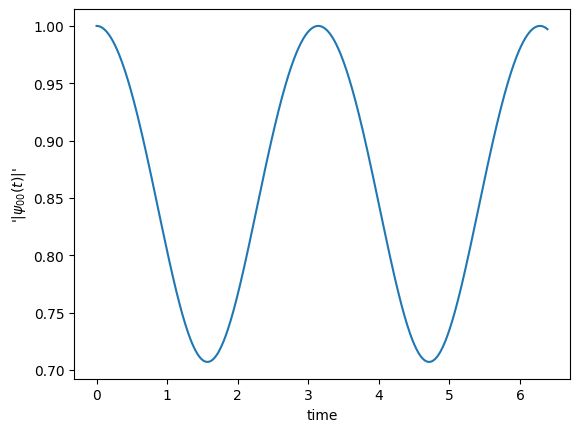

In [30]:
plt.xlabel("time")
plt.ylabel("'$|\psi_{00}(t)|$'")
plt.plot(time,psi11)

In [31]:
from qiskit.visualization import plot_bloch_multivector
import qiskit.quantum_info as qi

In [32]:
v0

array([[1],
       [0]])

In [33]:
state = qi.Statevector(v0) 

In [34]:
state

Statevector([1.+0.j, 0.+0.j],
            dims=(2,))


In [35]:
Had

array([[ 0.70710678,  0.70710678],
       [ 0.70710678, -0.70710678]])

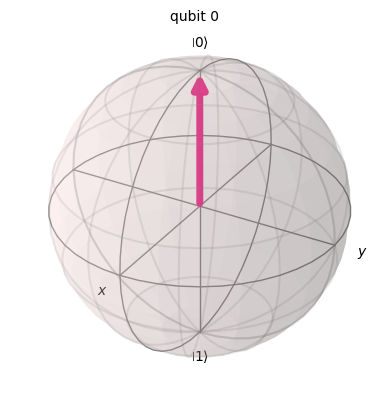

In [36]:
plot_bloch_multivector(state)

In [37]:
psi

array([[9.94300733e-01+0.07538585j],
       [6.74727476e-17+0.07538585j]])

In [38]:
X = np.array( [ [0,1], [1,0] ])
print(X)

[[0 1]
 [1 0]]


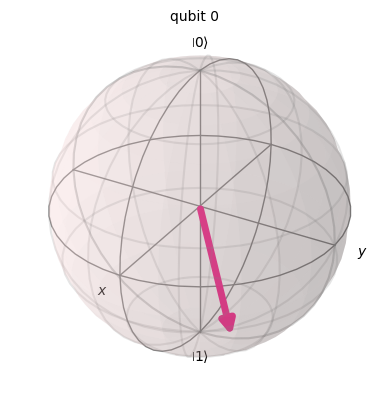

In [39]:
U = lng.expm(-1j*X*1.7)# 1.7 é o tempo
psi = U@v0
state = qi.Statevector(psi)
plot_bloch_multivector(state)

In [14]:
psi

array([[-0.12884449+0.j        ],
       [ 0.        -0.99166481j]])

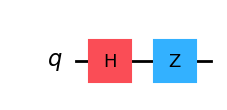

In [15]:
from qiskit import QuantumCircuit
from qiskit.visualization import visualize_transition

qc = QuantumCircuit(1)
qc.h(0)
qc.z(0)
qc.draw(output="mpl")

In [17]:
visualize_transition(qc, trace=True)